<a href="https://colab.research.google.com/github/ajsanjoaquin/colorizer_GAN/blob/main/Self_Supervized_Resnet_18.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# GAN Colorizer Training With PyTorch Lightning

#### December 2020
#### Created by Ayrton San Joaquin


---
We train a GAN to colorize images. Along the way, we learn a few things about different types of training and a cool framework ;). I adapted the code from [Moein's GAN Colorizer training](https://colab.research.google.com/github/moein-shariatnia/Deep-Learning/blob/main/Image%20Colorization%20Tutorial/Image%20Colorization%20with%20U-Net%20and%20GAN%20Tutorial.ipynb#scrollTo=S_b9HzPgYTpq). Full credit to his implementation of the GAN architecture and for his idea of using the Resnet-18 as the Generator Backbone!

This notebook is primarily meant to showcase the features of Pytorch Lightning and how it can streamline three different training tasks. We will use the images from the COCO Annotations Dataset for all three tasks. Some sample images will be shown later, along with the weights you can use to colorize your own images.

In [1]:
!pip install pytorch-lightning --quiet
!pip install fastai --upgrade --quiet
#!pip install torch==1.7.0+cu101 torchvision==0.8.2+cu101 -f https://download.pytorch.org/whl/torch_stable.html

     |████████████████████████████████| 675kB 16.1MB/s 
     |████████████████████████████████| 102kB 16.2MB/s 
     |████████████████████████████████| 829kB 43.5MB/s 
     |████████████████████████████████| 276kB 56.7MB/s 
     |████████████████████████████████| 194kB 16.8MB/s 
     |████████████████████████████████| 61kB 9.3MB/s 


In [1]:
import random
import os
from os.path import join
from collections import OrderedDict

from PIL import Image
from pathlib import Path
import numpy as np
from skimage.color import rgb2lab, lab2rgb
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision

from torchvision import transforms
import torchvision.transforms.functional as TF
from torch.utils.data import Dataset
from torch.utils.data import DataLoader

import pytorch_lightning as pl
from pytorch_lightning.loggers import TensorBoardLogger
from pytorch_lightning.callbacks import ModelCheckpoint
from fastai.vision.models.unet import DynamicUnet

# 1. Self-Supervised Pretraining
## Wait, where are the labels?
First we train a Resnet 18, which will be the backbone of the generator component of the Colorizer GAN, via self-supervision to decrease the number of necessary training epochs for our GAN model later on. This is called a pretraining task or pretext task.

For our self-supervized pretraining, we apply random transformations on the image and let our model try to classify the correct transformation label given the transformed image. This is basically the same training method with supervized training, except we do not assign any explicit labels to the image. 

After this pretraining, we expect that the model has learned some representation about objects, which can help the model distinguish objects for our downstream task. The downstream task here is coloring images, and the model needs to learn how to distinguish objects well to color them. 

### Dataset, Transformations, and Dataloaders
Each of these potential transforms has a separate label, giving us six potential labels for any image.

One thing I should do in the future is implement contrastive learning for the pretraining task...


In [2]:
import glob
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"
paths = glob.glob(coco_path + "/*.jpg") # Grabbing all the image file names

np.random.seed(123)
paths_subset = np.random.choice(paths, 10000, replace=False) # choosing 1000 images randomly
rand_idxs = np.random.permutation(10000)
train_idxs = rand_idxs[:8000] # choosing the first 8000 as training set
val_idxs = rand_idxs[8000:] # choosing last 2000 as validation set


train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
demo_paths = val_paths[:5]

Aside from the 6 different transformations (4 rotation transformations) part of [Ian's Implementation of Self-Supervized Learning with Pytorch Lightning](https://snappishproductions.com/blog/2020/05/25/image-self-supervised-training-with-pytorch-lightning.html.html), I added hue, saturation and brightness transformations into the mix. This gives us a total of 9 transformations. Since only one transformation is applied randomly to an image, we have a total of 9 classes.

In [4]:
class RotationalTransform:
  def __init__(self, angle):
    self.angle = angle

  def __call__(self, x):
    return TF.rotate(x, self.angle)

class VerticalFlip:
  def __init__(self):
    pass
  def __call__(self, x):
    return TF.vflip(x)

class HorizontalFlip:
  def __init__(self):
    pass
  def __call__(self, x):
    return TF.hflip(x)

class HueChange:
  def __init__(self):
    pass
  def __call__(self, x):
    rnd = 0
    # prevent rnd from becoming 0, which returns the original image
    while rnd == 0:
      rnd = np.random.uniform(-0.5, 0.5) 
    return TF.adjust_hue(x, rnd)

class SaturationChange:
  def __init__(self):
    pass
  def __call__(self, x):
    rnd = 1
    # prevent rnd from becoming 1, which returns the original image
    while rnd == 1:
      rnd = np.random.uniform(0.25, 4) 
    return TF.adjust_saturation(x, rnd)

class BrightnessChange:
  def __init__(self):
    pass
  def __call__(self, x):
    rnd = 1
    # prevent rnd from becoming 1, which returns the original image
    while rnd == 1:
      rnd = np.random.uniform(0.5, 2) 
    return TF.adjust_brightness(x, rnd)


We'll then wrap those transforms up inside a `Dataset` class, which will apply a chosen transformation when `__getitem__` is called, as well as returning the correct label for that transform.  

In [5]:
class SelfSupervisedDataset(object):
  def __init__(self, image_path):
    #self.imgs = list(image_path.glob('**/*.JPEG'))
    self.imgs = image_path
    self.class_transforms = [RotationalTransform(0), RotationalTransform(90), 
                       RotationalTransform(180), RotationalTransform(270), 
                       HorizontalFlip(),VerticalFlip(), BrightnessChange(), 
                       SaturationChange(), HueChange()]
    self.to_tensor = transforms.Compose([transforms.ToTensor()])                       
    self.classes = len(self.class_transforms)

  def __getitem__(self, idx):
    img = Image.open(self.imgs[idx]).convert("RGB")
    label = random.choice(range(0, self.classes))

    # Resize first, then apply our selected transform and finally convert to tensor, then normalize
    transformed_image = transforms.Resize((224,224))(img)
    transformed_image = self.class_transforms[label](transformed_image)
    transformed_image = self.to_tensor(transformed_image)
    transformed_image = transforms.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))(transformed_image)
    return transformed_image, label

  def __len__(self):
    return len(self.imgs)

### ResNet-18!

We extend the provided _LightningModule_ class. Notice that we don't have any for loops or the usualy Pytorch methods such as .backwards() to do the backward step of backpropagation. Lightning handles those automatically behind the scenes, so code is more readable. Note that the function _forward_ is defined for inference and _training_step_ outlines what must happen during training.

These functions must be named exactly for Lightning to use them. See the docs for the complete list. Once the epoch ends, we log both train & valid accuracies/loss on our logger. We use Tensorboard for this.

Take note that we declare learning_rate and batch_size, which are examples of hyperparameters that Lightning can automatically tune for us later!

In [6]:
class SelfSupervisedModel(pl.LightningModule):
   
  # There are nine classes because of the nine transformations
  def __init__(self, batch_size, max_epochs = 10, learning_rate=0.001, num_classes=9):
    super(SelfSupervisedModel, self).__init__()

    self.resnet = torchvision.models.resnet18(pretrained=False)
    self.resnet.fc = nn.Sequential(nn.Linear(512, 256), nn.ReLU(), nn.Linear(256, num_classes))

    self.loss_fn = nn.CrossEntropyLoss()

    self.max_epochs = max_epochs
    self.learning_rate= learning_rate
    self.batch_size = batch_size

    self.dataset_length = 596

    self.save_hyperparameters()

    # Built-in API for metrics
    self.train_accuracy = pl.metrics.Accuracy()
    self.val_accuracy = pl.metrics.Accuracy()

  def forward(self, x):
    return self.resnet(x)

  def training_step(self, batch, batch_idx):
    inputs, targets = batch
    predictions = self(inputs)
    loss = self.loss_fn(predictions, targets)

    #takes the highest value from the class columns and checks if it is equal to the value of the target
    acc = predictions.argmax(dim=1).eq(targets).sum().item() / len(targets)

    return {'loss': loss, 'accuracy': acc}

  def training_epoch_end(self,outputs):
    #avg loss 
    avg_loss=torch.stack([x["loss"] for x in outputs]).mean()

    accuracy=sum([x["accuracy"] for x in outputs])

    self.logger.experiment.add_scalars("Losses", {"train_loss": avg_loss}, self.current_epoch)
    self.logger.experiment.add_scalars("Accuracies", {"train_accuracy": accuracy}, self.current_epoch)

  def prepare_data(self):
    self.training_dataset = SelfSupervisedDataset(train_paths)
    self.val_dataset = SelfSupervisedDataset(val_paths)
    
  def train_dataloader(self):
    return DataLoader(self.training_dataset, batch_size=self.batch_size, num_workers=4, shuffle=True)
    

  def val_dataloader(self):
    return DataLoader(self.val_dataset, batch_size=self.batch_size, num_workers=4)

  def configure_optimizers(self):
    #let's try using 1CycleLR on ADAM
    optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)
    scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr=0.01, \
                                                    steps_per_epoch=self.dataset_length, epochs=self.max_epochs)
    return [optimizer] , [scheduler]

  def validation_step(self, batch, batch_idx):
    inputs, targets = batch
    predictions = self(inputs)
    val_loss = self.loss_fn(predictions, targets)
    _, preds = torch.max(predictions, 1)
    acc = torch.sum(preds == targets.data) / (targets.shape[0] * 1.0)
    return {'val_loss': val_loss, 'val_acc': acc}

  
  def validation_epoch_end(self, outputs):
    avg_loss = torch.stack([x['val_loss'] for x in outputs]).mean()
    avg_acc = torch.stack([x['val_acc'].float() for x in outputs]).mean()
    logs = {'val_loss': avg_loss, 'val_acc': avg_acc}

    self.logger.experiment.add_scalars("Losses", {'val_loss': avg_loss}, self.current_epoch)
    self.logger.experiment.add_scalars("Accuracies", {'val_acc': avg_acc}, self.current_epoch)
  

We now define the Trainer class where we incorporate all of our parameters. Furthermore, we use the tuner method to find the learning rate. We can also call perform search for an optimal batch_size via Power search of Binary search. 

Lightning has the highly useful callbacks I used in fast.ai, except that Lightning calls natively to Pytorch! This is extremely useful for debugging and having a limited number of necessary packages to use in virtual environments and in docker containers. 

The batch_size was found using binary search built within Lightning's batch_size tuner method. We also found the optimal learning rate via Lightning's _lr_find_ method.

/usr/local/lib/python3.6/dist-packages/pytorch_lightning/utilities/distributed.py:49: UserWarning: You have set progress_bar_refresh_rate < 20 on Google Colab. This may crash. Consider using progress_bar_refresh_rate >= 20 in Trainer.
  warnings.warn(*args, **kwargs)
GPU available: True, used: True
TPU available: None, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Using native 16bit precision.

  | Name           | Type             | Params
----------------------------------------------------
0 | resnet         | ResNet           | 11.3 M
1 | loss_fn        | CrossEntropyLoss | 0     
2 | train_accuracy | Accuracy         | 0     
3 | val_accuracy   | Accuracy         | 0     
----------------------------------------------------
11.3 M    Trainable params
0         Non-trainable params
11.3 M    Total params


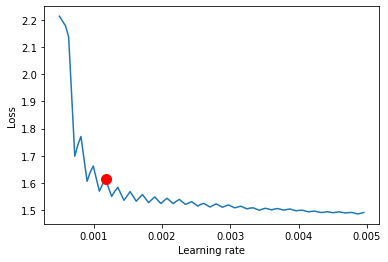

In [7]:
model = SelfSupervisedModel(batch_size = 1150)

#define the full TBLogger
logger = TensorBoardLogger('log', name='self_res18')
checkpoint_callback = ModelCheckpoint(monitor='val_loss')

#enable gradient accumulation and 16-bit mixed precision for faster training and less memory usage
trainer = pl.Trainer(max_epochs=30, gpus=1,  \
                     accumulate_grad_batches=2, precision=16, \
                     logger=logger, callbacks=[checkpoint_callback])

lr_finder = trainer.tuner.lr_find(model, 
                        min_lr=0.0005, 
                        max_lr=0.005,
                        mode='linear')

# Plots the optimal learning rate
fig = lr_finder.plot(suggest=True)
fig.show()

#set suggested LR as the model's LR
model.learning_rate = lr_finder.suggestion()

#model.learning_rate = 0.001175

In [8]:
# finds learning rate automatically
# sets hparams.lr or hparams.learning_rate to that learning rate
#trainer.tune(model)
trainer.fit(model)


  | Name           | Type             | Params
----------------------------------------------------
0 | resnet         | ResNet           | 11.3 M
1 | loss_fn        | CrossEntropyLoss | 0     
2 | train_accuracy | Accuracy         | 0     
3 | val_accuracy   | Accuracy         | 0     
----------------------------------------------------
11.3 M    Trainable params
0         Non-trainable params
11.3 M    Total params


1

In [9]:
%reload_ext tensorboard
%tensorboard --logdir log

Reusing TensorBoard on port 6006 (pid 987), started 1:27:40 ago. (Use '!kill 987' to kill it.)

<IPython.core.display.Javascript object>

In [10]:
#trainer.save_checkpoint("self_res18.pth")
torch.save(model.resnet.state_dict(), 'self_res18_weights.pth')
#cp self_res18_weights.pth drive/MyDrive/
#untrained was 40% accuracy
#pretrained is 57% accuracy

# 2. Generator Pretraining
Now, we "warm-up" our Generator (Resnet18 backbone + Unet architecture) by training it on colorizing images in a supervised manner. Our model will read every image as a La\*b\* image instead of our usual RGB. For this training task, given a grayscale image (L value), it predicts 2 values(a\* & b*\), which is computationally more efficient than predicting 3 values (RGB) given a grayscale image.

In [3]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(),
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)
        
        self.split = split
        self.size = SIZE
        #self.imgs = list(paths.glob('**/*.JPEG'))
        self.imgs = paths
        
    def __getitem__(self, idx):
        img = Image.open(self.imgs[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
    
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}

    def __len__(self):
        return len(self.imgs)

In [4]:
#@title Architectures
#Discriminator Architecture Component - Analyzes subsections of the image instead of the whole image
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

#Adversarial Loss
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real).to(torch.device('cuda'))
        loss = self.loss(preds, labels)
        return loss

#Utility function
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

In [5]:
class Pretrain_Gen(pl.LightningModule):
    def __init__(self, batch_size=16, net_G=None, max_epochs = 5, lr=2e-4, 
                 b1=0.5, b2=0.999, lambda_L1=100.):
        super().__init__()

        self.lr=lr
        self.b1=b1
        self.b2=b2
        self.lambda_L1 = lambda_L1
        self.net_G = net_G
        self.batch_size=batch_size

        self.max_epochs=max_epochs

        self.dataset_length= len(ColorizationDataset(train_paths, split="train"))
      
    def l1_loss (self, y, y_hat):
        loss=nn.L1Loss()
        return loss(y, y_hat)

    #Optimizers
    def configure_optimizers(self):
        lr = self.lr
        b1 = self.b1
        b2 = self.b2

        #let's try using 1CycleLR on ADAM

        opt_g = torch.optim.Adam(self.net_G.parameters(), lr=lr, betas=(b1, b2))
        scheduler = torch.optim.lr_scheduler.OneCycleLR(opt_g, max_lr=0.01, \
                                                        steps_per_epoch=self.dataset_length, epochs=self.max_epochs)
        return opt_g
        
    def forward(self, x):
        return self.net_G(x)

    def training_step(self, batch, batch_idx):
      l, ab = batch['L'], batch['ab']

      #We are only interested in l1 loss (Reconstruction error)
      generated_imgs = self.net_G(l)
      loss = self.l1_loss(generated_imgs, ab)

      correct=generated_imgs.eq(ab).sum().item()

      total=len(ab)

      return {'loss': loss,
              'correct': correct,
              'total': total}

    def training_epoch_end(self,outputs):
      #avg loss 
      avg_loss=torch.stack([x["loss"] for x in outputs]).mean()

      correct=sum([x["correct"] for x in outputs])
      total=sum([x["total"] for x in outputs])

      self.logger.experiment.add_scalars("Losses", {"train_loss": avg_loss}, self.current_epoch)
      self.logger.experiment.add_scalars("Accuracies", {"train_accuracy": correct/total}, self.current_epoch)
    
    def prepare_data(self):
      self.train_dataset=ColorizationDataset(train_paths, split="train")
      

    def train_dataloader(self):
      return DataLoader(self.train_dataset, batch_size=self.batch_size, num_workers=4)

Fastai has a convenient function (_DyanmicUnet_) which creates a Unet architecture given an arbitrary base architecture. In this case, we use the resnet18.

In [6]:
def build_res_unet(checkpoint=None, n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    #remove the last 2 layers of resnet 18 then create a Unet from it
   
    body = torchvision.models.resnet18(pretrained=False)
    #Modify the head as we did in our self-supervised pretraining with 6 classes
    body.fc = nn.Sequential(nn.Linear(512, 256), nn.ReLU(), nn.Linear(256, 9))
    if checkpoint:
      body.load_state_dict(torch.load(checkpoint, map_location=device))
    #change number of input channels
    body.conv1 = nn.Conv2d(n_input, 64, kernel_size=7, stride=2, padding=3,bias=False)

    body=nn.Sequential(*list(body.children())[:-2])
    net_G = DynamicUnet(body, n_output, (size, size))
    return net_G

Again, we define our Trainer and our new generator model and pass the needed loggers and callbacks.

In [17]:
generator=build_res_unet('self_res18_weights.pth')
model = Pretrain_Gen(batch_size = 16, net_G=generator, max_epochs=5)

logger = TensorBoardLogger('log', name='pre_gen')
checkpoint_callback = ModelCheckpoint(monitor='val_loss')

trainer = pl.Trainer(max_epochs=20, gpus=1, \
                     accumulate_grad_batches=2, precision=16, \
                     logger=logger, callbacks=[checkpoint_callback])
#trainer.tune(model)
trainer.fit(model)

/usr/local/lib/python3.6/dist-packages/pytorch_lightning/utilities/distributed.py:49: UserWarning: You have set progress_bar_refresh_rate < 20 on Google Colab. This may crash. Consider using progress_bar_refresh_rate >= 20 in Trainer.
  warnings.warn(*args, **kwargs)
GPU available: True, used: True
TPU available: None, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Using native 16bit precision.

  | Name  | Type        | Params
--------------------------------------
0 | net_G | DynamicUnet | 31.1 M
--------------------------------------
31.1 M    Trainable params
0         Non-trainable params
31.1 M    Total params


1

In [18]:
torch.save(model.net_G.state_dict(),'gen_res18_weights.pth' )

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir log

In [7]:
def lab_to_rgb(L, ab, train=False):
    """
    Takes a batch of images
    """
    L = (L + 1.) * 50.
    ab = ab * 110.
    if train:
        Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().detach().numpy()  
    else:
        Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

# 3. GAN Training
Now, we proceed to the main training of our GAN model. It contains 2 models: The Generator and the Discriminator. Pytorch Lightning supports GAN training and the most noticeable feature is seen in _training_step_ where our Generator and Discriminators are trained sequentially given the optimizer index. 

Lightning returns a tuple of optimizers in _configure_optimizers_ and selects the optimizer and its index based on the step in the training, which is then passed to _training_step_.

In [8]:
class MainModel(pl.LightningModule):
    def __init__(self, batch_size = 16, net_G=None, lr=2e-4, 
                 b1=0.5, b2=0.999, lambda_L1=100.):
        super().__init__()

        self.lambda_L1 = lambda_L1
        self.lr=lr
        self.b1=b1
        self.b2=b2
        self.batch_size = batch_size
        
        #Models
        if net_G is None:
            self.net_G = init_weights(Unet(input_c=1, output_c=2, n_down=8, num_filters=64))
        else:
            self.net_G = net_G
        self.net_D = init_weights(PatchDiscriminator(input_c=3, n_down=3, num_filters=64))

    #Loss Functions
    def adversarial_loss(self, preds, real):
        return GANLoss(gan_mode='vanilla')(preds, real)#.to(torch.device('cuda'))
      
    def l1_loss (self, y, y_hat):
        loss=nn.L1Loss()
        return loss(y, y_hat)

    #Optimizers
    def configure_optimizers(self):
        opt_g = torch.optim.Adam(self.net_G.parameters(), lr=self.lr, betas=(self.b1, self.b2))
        opt_d = torch.optim.Adam(self.net_D.parameters(), lr=self.lr, betas=(self.b1, self.b2))
        return opt_d , opt_g 
        
    def forward(self, x):
        return  self.net_G(x)
        

    def training_step(self, batch, batch_idx, optimizer_idx):
      '''
      We train the Generator first. Given the grayscale image (l), the model predicts a* & b*.
      fake image is made by concactenating l and the produced a* & b*. 
      Generator loss = adversarial loss + l1 loss
      l1 measures distance of generated a* & b* with actual a* & b*

      Next, we train Discriminator. 
      Discriminator loss = real loss (how well it performs on real image)
      + fake loss (how well it performs on fake image)

      Objective is to make fake images undistinguishable to real images (i.e. maximize fake loss?)
      
      We train the discriminator first like in the original implementation
      '''
      l, ab = batch['L'], batch['ab']

      #Train Generator
      generated_imgs = self.net_G(l)
      if optimizer_idx == 1:

        #log sampled image
        if batch_idx == 1 :
          sample_imgs = lab_to_rgb(l,generated_imgs, train=True)
          real_imgs = lab_to_rgb(l, ab)
          fig = plt.figure(figsize=(15, 8))
          for i in range(4):
              ax = plt.subplot(3, 5, i + 1)
              ax.imshow(l[i][0].cpu(), cmap='gray')
              ax.axis("off")
              ax = plt.subplot(3, 5, i + 1 + 5)
              ax.imshow(sample_imgs[i])
              ax.axis("off")
              ax = plt.subplot(3, 5, i + 1 + 10)
              ax.imshow(real_imgs[i])
              ax.axis("off")
          plt.show()
          plt.clf()
        
        #sample = (sample_imgs[0]*255).astype(np.uint8)
        #grid is expensive
        #test=[((torch.from_numpy(imgs)).permute(2, 0, 1)) for imgs in sample_imgs]
        #grid = torchvision.utils.make_grid([(imgs*255).astype('uint8') for imgs in sample_imgs])
        
        #self.logger.experiment.add_image('generated_images', sample, 0)

        fake_images = torch.cat([l, generated_imgs], dim=1)
        fake_preds = self.net_D(fake_images)

        # Set as real image because Generator doesnt distinguish
        loss_G_GAN = self.adversarial_loss(fake_preds, True)
        loss_G_L1 = self.l1_loss(generated_imgs, ab) * self.lambda_L1
        loss_G = loss_G_GAN + loss_G_L1

        tqdm_dict = {'g_loss': loss_G}
        output = OrderedDict({
            'loss': loss_G,
            'progress_bar': tqdm_dict,
            'log': tqdm_dict
        })

        return output
      
      # Train Discriminator
      if optimizer_idx == 0:
        #Was backward_D(self)

        #measure fake image performance
        fake_image = torch.cat([l, generated_imgs], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        loss_D_fake = self.adversarial_loss(fake_preds, False)
        
        #measure real image performance
        real_image = torch.cat([l, ab], dim=1)
        real_preds = self.net_D(real_image)
        loss_D_real = self.adversarial_loss(real_preds, True)

        #Discriminator Loss is the average
        loss_D = (loss_D_fake + loss_D_real) * 0.5
        #self.loss_D.backward()
        tqdm_dict = {'d_loss': loss_D}
        output = OrderedDict({
            'loss': loss_D,
            'progress_bar': tqdm_dict,
            'log': tqdm_dict
        })

        return output

    def prepare_data(self):
      self.train_dataset=ColorizationDataset(train_paths)
      self.valid=ColorizationDataset(val_paths)
    
    def train_dataloader(self):
      return DataLoader(self.train_dataset, batch_size=self.batch_size, num_workers=4)
        
    def valid_dataloader(self):
      return DataLoader(self.valid, batch_size=self.batch_size, num_workers=4)

Training will be performed using the `Trainer` class again, but this time we'll pass in these new training and validation dataloaders, which will override the ones we defined in the actual class (and `prepare_dataset` will not be called by PyTorch Lightning during this training phase).

/usr/local/lib/python3.6/dist-packages/pytorch_lightning/utilities/distributed.py:49: UserWarning: You have set progress_bar_refresh_rate < 20 on Google Colab. This may crash. Consider using progress_bar_refresh_rate >= 20 in Trainer.
  warnings.warn(*args, **kwargs)
GPU available: True, used: True
TPU available: None, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Using native 16bit precision.


model initialized with norm initialization



  | Name  | Type        | Params
--------------------------------------
0 | net_G | DynamicUnet | 31.1 M
--------------------------------------
31.1 M    Trainable params
0         Non-trainable params
31.1 M    Total params



  | Name  | Type               | Params
---------------------------------------------
0 | net_G | DynamicUnet        | 31.1 M
1 | net_D | PatchDiscriminator | 2.8 M 
---------------------------------------------
33.9 M    Trainable params
0         Non-trainable params
33.9 M    Total params


/usr/local/lib/python3.6/dist-packages/pytorch_lightning/utilities/distributed.py:49: UserWarning: The {progress_bar:dict keyword} was deprecated in 0.9.1 and will be removed in 1.0.0
Please use self.log(...) inside the lightningModule instead.

# log on a step or aggregate epoch metric to the logger and/or progress bar
# (inside LightningModule)
self.log('train_loss', loss, on_step=True, on_epoch=True, prog_bar=True)
  warnings.warn(*args, **kwargs)
/usr/local/lib/python3.6/dist-packages/pytorch_lightning/utilities/distributed.py:49: UserWarning: The {log:dict keyword} was deprecated in 0.9.1 and will be removed in 1.0.0
Please use self.log(...) inside the lightningModule instead.

# log on a step or aggregate epoch metric to the logger and/or progress bar
# (inside LightningModule)
self.log('train_loss', loss, on_step=True, on_epoch=True, prog_bar=True)
  warnings.warn(*args, **kwargs)


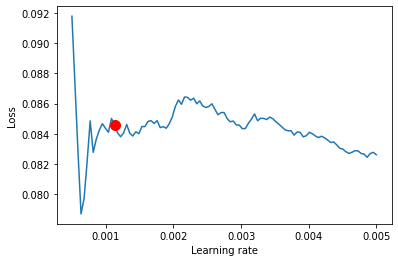

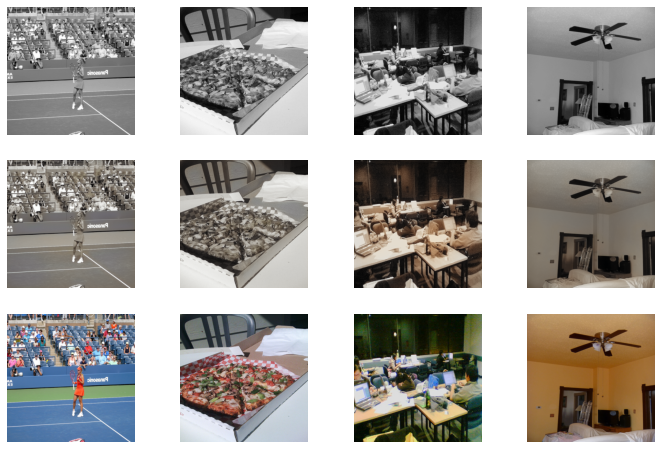

<Figure size 432x288 with 0 Axes>

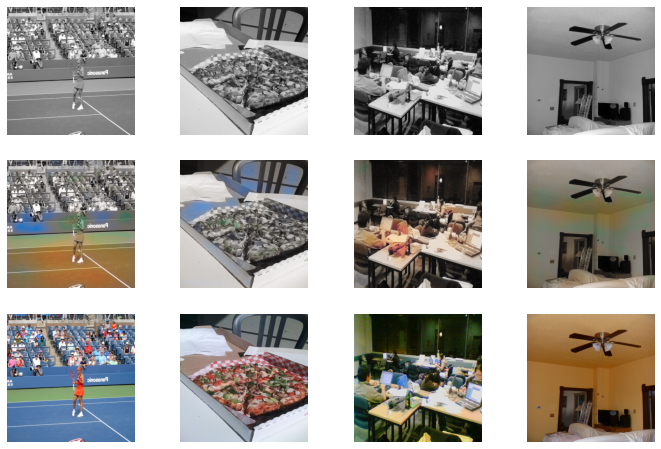

<Figure size 432x288 with 0 Axes>

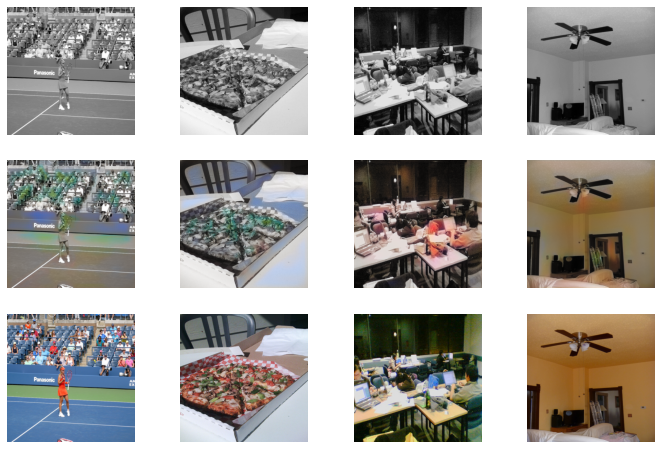

/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 82 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 101 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 34 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


<Figure size 432x288 with 0 Axes>

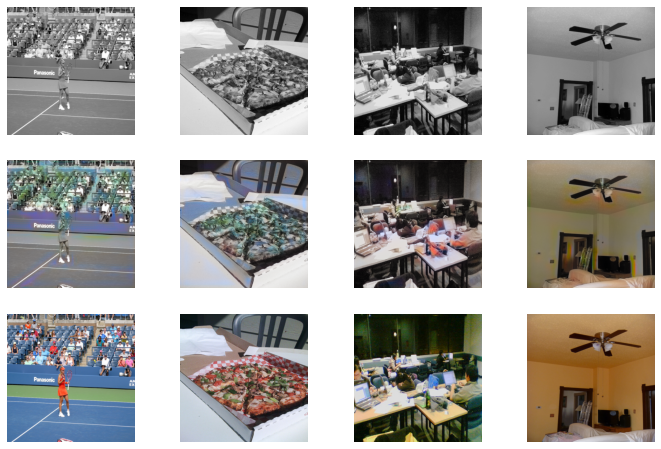

/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 55 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 102 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 151 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 37 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


<Figure size 432x288 with 0 Axes>

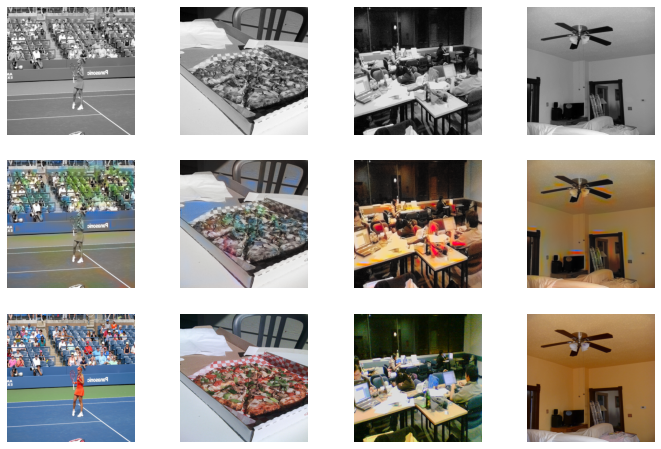

/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


<Figure size 432x288 with 0 Axes>

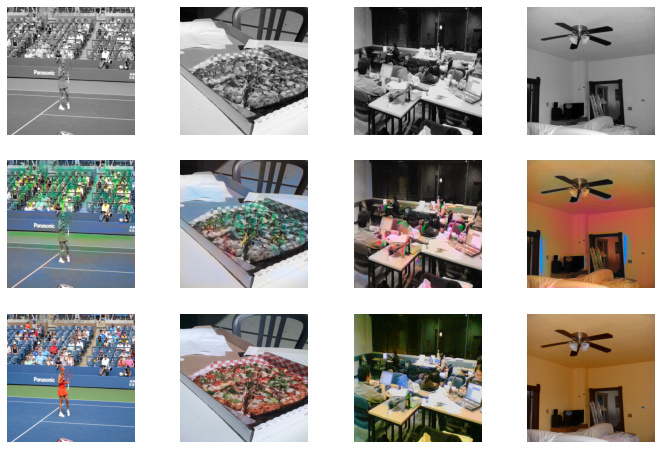

<Figure size 432x288 with 0 Axes>

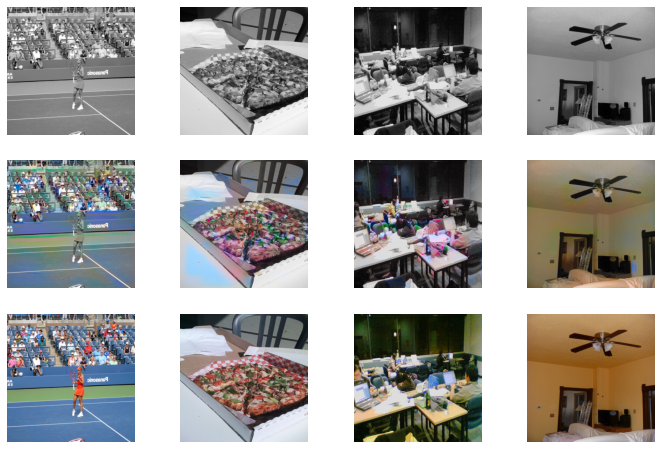

/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 58 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 21 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


<Figure size 432x288 with 0 Axes>

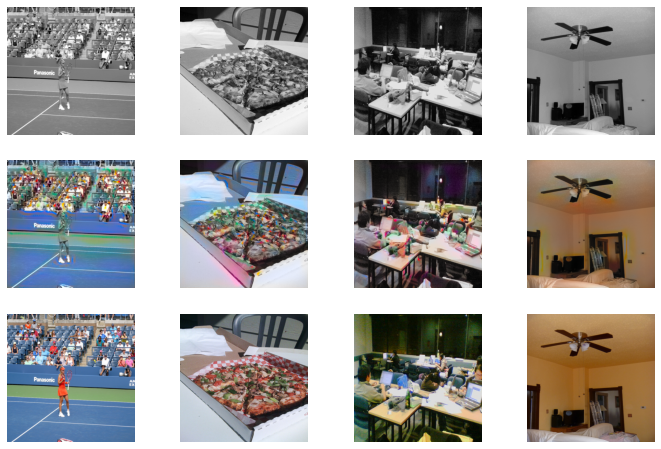

/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 36 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


<Figure size 432x288 with 0 Axes>

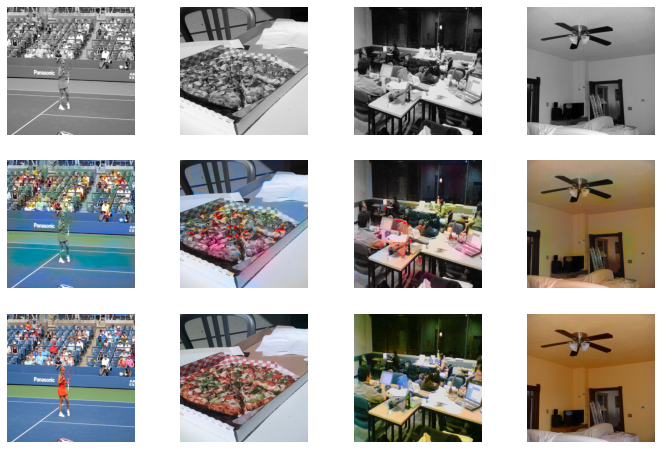

<Figure size 432x288 with 0 Axes>

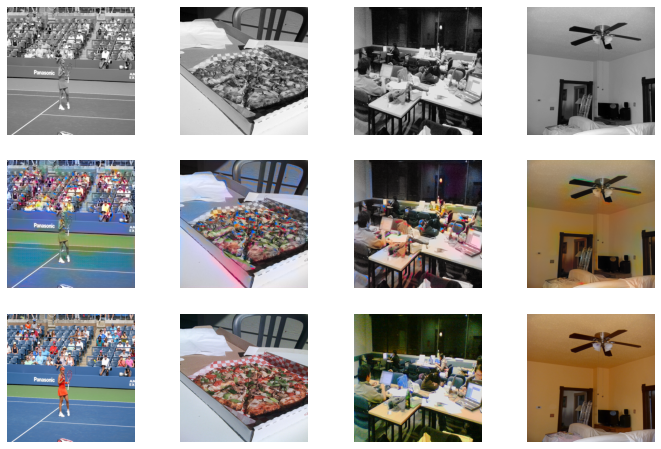

/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


<Figure size 432x288 with 0 Axes>

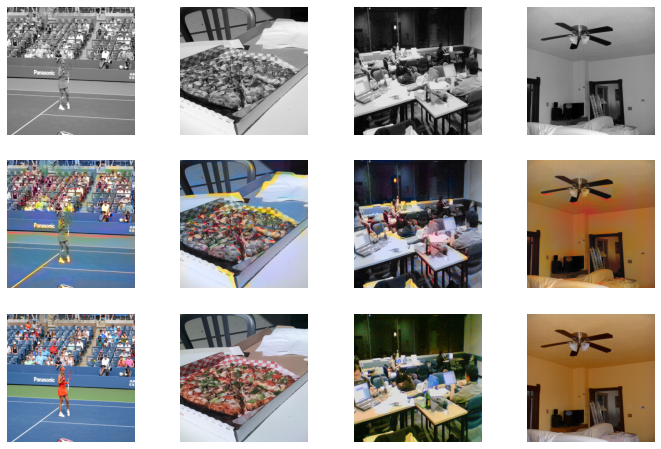

<Figure size 432x288 with 0 Axes>

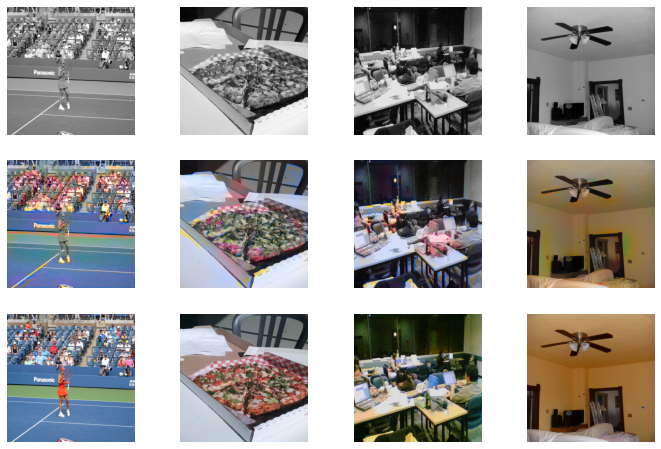

<Figure size 432x288 with 0 Axes>

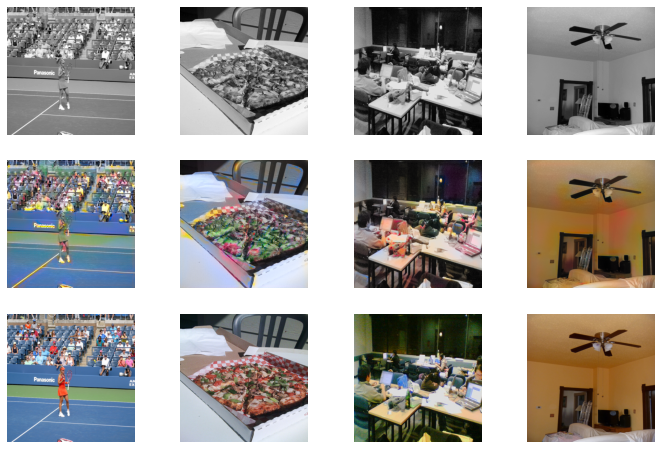

<Figure size 432x288 with 0 Axes>

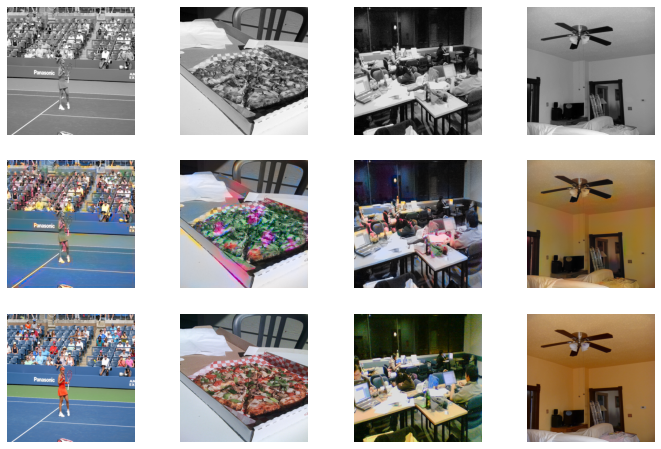

/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


<Figure size 432x288 with 0 Axes>

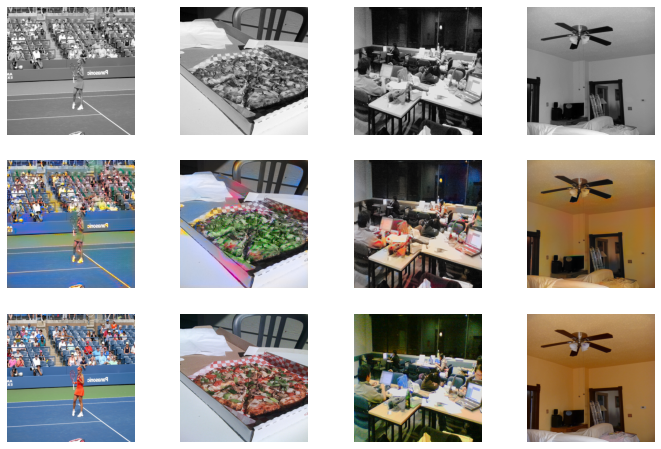

<Figure size 432x288 with 0 Axes>

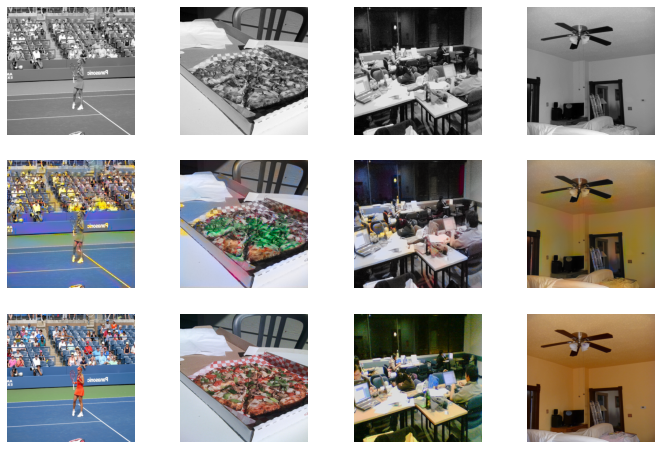

/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 254 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 60 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


<Figure size 432x288 with 0 Axes>

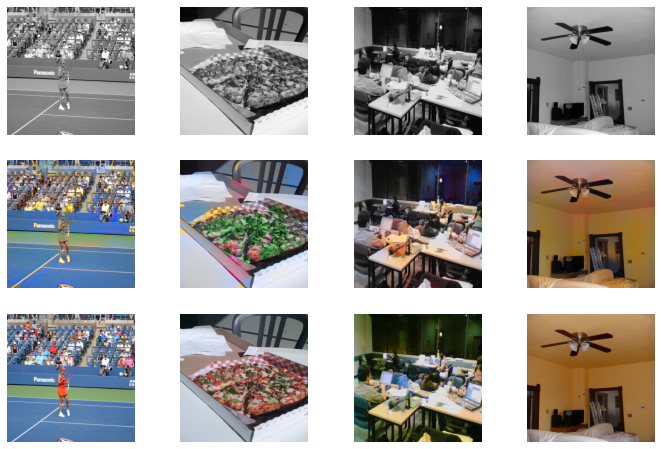

/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


<Figure size 432x288 with 0 Axes>

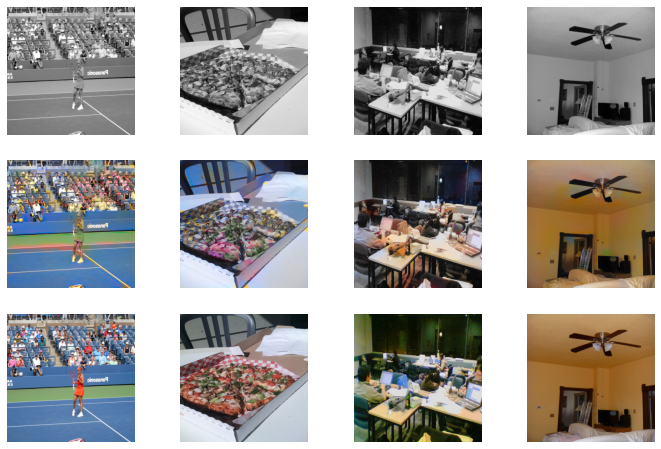

/usr/local/lib/python3.6/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


<Figure size 432x288 with 0 Axes>

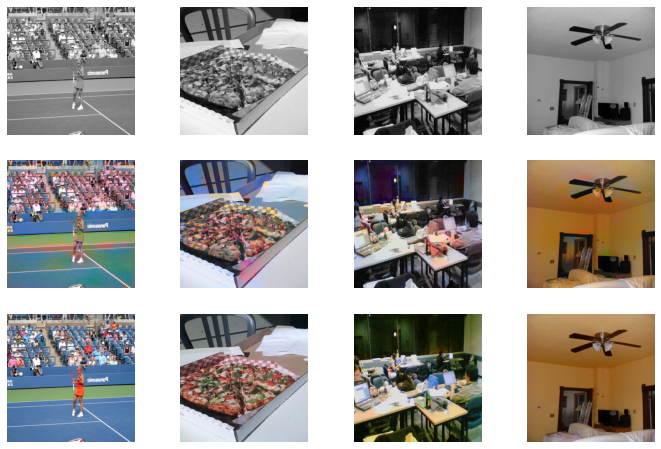

1

<Figure size 432x288 with 0 Axes>

In [25]:
generator=build_res_unet()
generator.load_state_dict(torch.load('gen_res18_weights.pth'))
gan=MainModel(batch_size = 16, net_G=generator)

logger = TensorBoardLogger('log', name='gan')


trainer = pl.Trainer(max_epochs=20, gpus=1, accumulate_grad_batches=2, precision=16, \
                     logger=logger)
# find the batch size
#trainer.tune(gan)
lr_finder = trainer.tuner.lr_find(model, 
                        min_lr=0.0005, 
                        max_lr=0.005,
                        mode='linear')

# Plots the optimal learning rate
fig = lr_finder.plot(suggest=True)
fig.show()

#set suggested LR as the model's LR
model.learning_rate = lr_finder.suggestion()


trainer.fit(gan)

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir log/

In [16]:
#torch.save(gan.state_dict(), 'gan_weights_20_autolr.pth')
#from google.colab import drive
#drive.mount('/content/drive')
!cp /content/gan_weights_20_autolr.pth /content/drive/MyDrive/gan_weights_20_autolr.pth

# Inference

Now, we test our model by colorizing images. The model can colorize any images. Our function _test_ converts any image into La\*b\*  and then takes the L value (grayscale), then our model predicts the remaining values. Finally, it reconverts it into RGB value. 

Note that this model does not guarantee an accurate colorization of an image because colorization is always open to interpretation by the colorizer (whether it be a human or a machine). For example, unless the exact situation and time period is knowable based on the image, a shirt within the image can be of almost any color.

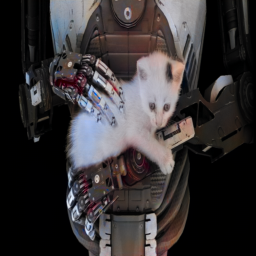

In [14]:
#You can load my pretrained weights here (which I used on the image above).

#!gdown https://drive.google.com/uc?id=1t5Y1nt8aoQxGXkrQifYzP7-nIPKqgMef
#net_G = build_res_unet(n_input=1, n_output=2, size=256)
#gan = MainModel(net_G=net_G)
#gan.load_state_dict(torch.load('/content/gan_weights_20_autolr.pth'))

model initialized with norm initialization


<All keys matched successfully>

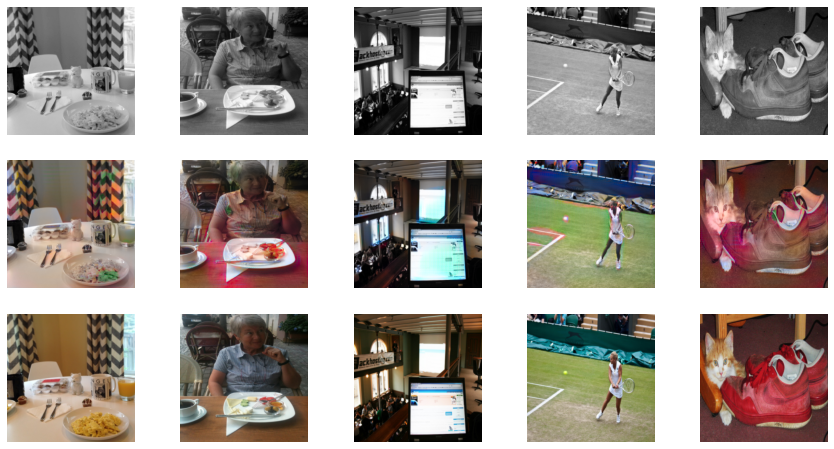

In [11]:
gan.eval()

def test(model, in_dir, out_dir, filename='colored', numpy=False, plot=False):
  '''
  Colorizes any image. If resize is true, it 
  produces a 256 x 256 image regardless of input dimensions
  to save computation
  '''
  if numpy:
    img_list=in_dir
  else:
    img_list = [f for f in os.listdir(in_dir) if f.endswith(('.png','.jpg','.jpeg'))]
  L_list=[]
  ab_list=[]

  if not os.path.isdir(out_dir):
    os.makedirs(out_dir)

  for image in img_list:
    if numpy:
      img = Image.open(image).convert("RGB")
    else:
      img = Image.open(join(in_dir,image)).convert("RGB")

    img = transforms.Resize((256, 256))(img)

    img = np.array(img)
    img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
    img_lab=torch.from_numpy(img_lab)
    img_lab=img_lab.permute(2,0,1)

    L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
    if plot:
      ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
      ab = ab.unsqueeze(0)
      ab_list.append(ab)

    L=L.unsqueeze(0)
    L_list.append(L)

  #convert the L list into a tensor
  L_list=torch.cat([imgs for imgs in L_list],dim=0)

  #model accepts batch predictions
  with torch.no_grad():
    pred=model.net_G(L_list)

  generated = lab_to_rgb(L_list,pred)

  if plot:
    ab_list=torch.cat([imgs for imgs in ab_list],dim=0)
    real_imgs = lab_to_rgb(L_list, ab_list)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
          ax = plt.subplot(3, 5, i + 1)
          ax.imshow(L_list[i][0].cpu(), cmap='gray')
          ax.axis("off")
          ax = plt.subplot(3, 5, i + 1 + 5)
          ax.imshow(generated[i])
          ax.axis("off")
          ax = plt.subplot(3, 5, i + 1 + 10)
          ax.imshow(real_imgs[i])
          ax.axis("off")
    plt.show()

  else:
    for index, colored in enumerate(generated):
      Image.fromarray((colored*255).astype('uint8')).save(join(out_dir,filename+str(index)+'.png'))

#Colorize!
test(gan, demo_paths,'/content/outputs',numpy=True ,plot=True)

I also trained on [Imagenette](https://github.com/fastai/imagenette), subjecting it to the same training regime shown here. However, it performed way worse with the colorization task on both COCO and Imagenette images.

I believe that this is because COCO images generally have more objects, owing to its object annotation objective, and therefore more color variety compared to Imagenette, whose images are focused on a single object and may have less color variety.